# DATA VISUALIZATION

## Loading the dataset

First things first, we will import the required libraries

In [1]:
# import pandas
import pandas as pd
import plotly.express as px

Now, we will load the cleaned dataset into the notebook

In [2]:
# Read the dataset 'quakes-cleaned.csv' into a pandas DataFrame.
# Use the values in the first column as the index for the DataFrame.
df = pd.read_csv('quakes-cleaned.csv', index_col=0)

Let us see the first few rows in the dataset

In [3]:
df.head()

,time.1,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource,state_country
time,,,,,,,,,,,,,,,,,,,,,
2023-11-15 09:05:07.304000+00:00,2023-11-15 09:05:07.304000+00:00,61.580800,-149.847000,32.800000,1.70,ml,0,0.0,0.0,0.22,...,"5 km SSW of Houston, Alaska",earthquake,0.00,0.20,0.00,0,automatic,ak,ak,"Beavertail Drive, Matanuska-Susitna, Alaska, U..."
2023-11-15 08:53:06.688000+00:00,2023-11-15 08:53:06.688000+00:00,61.079400,-147.883000,14.800000,1.00,ml,0,0.0,0.0,0.80,...,"55 km NE of Whittier, Alaska",earthquake,0.00,0.30,0.00,0,automatic,ak,ak,"Chugach, Alaska, United States"
2023-11-15 08:41:52.480000+00:00,2023-11-15 08:41:52.480000+00:00,19.380667,-155.285339,0.320000,1.73,md,15,153.0,0.0,0.20,...,"8 km SW of Volcano, Hawaii",earthquake,0.33,0.38,0.59,15,automatic,hv,hv,"Volcano, Volcano CDP, Hawaiʻi County, Hawaii, ..."
2023-11-15 07:44:53.035000+00:00,2023-11-15 07:44:53.035000+00:00,61.638200,-149.782800,32.900000,1.90,ml,0,0.0,0.0,0.31,...,Others,earthquake,0.00,0.20,0.00,0,automatic,ak,ak,"Houston, Matanuska-Susitna, Alaska, 99694, Uni..."
2023-11-15 07:19:44.540000+00:00,2023-11-15 07:19:44.540000+00:00,18.972166,-155.451660,34.759998,1.87,md,37,236.0,0.0,0.12,...,"17 km SE of Naalehu, Hawaii",earthquake,0.71,0.89,0.88,5,automatic,hv,hv,United States


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 19244 entries, 2023-11-15 09:05:07.304000+00:00 to 2023-09-01 00:04:57.310000+00:00
Data columns (total 23 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   time.1           19244 non-null  object 
 1   latitude         19244 non-null  float64
 2   longitude        19244 non-null  float64
 3   depth            19244 non-null  float64
 4   mag              19244 non-null  float64
 5   magType          19244 non-null  object 
 6   nst              19244 non-null  int64  
 7   gap              19244 non-null  float64
 8   dmin             19244 non-null  float64
 9   rms              19244 non-null  float64
 10  net              19244 non-null  object 
 11  id               19244 non-null  object 
 12  updated          19244 non-null  object 
 13  place            19244 non-null  object 
 14  type             19244 non-null  object 
 15  horizontalError  19244 non-null  float64
 16  depth

In [8]:
# Assuming your DataFrame is named df
df['time.1'] = pd.to_datetime(df['time.1'], errors='coerce')  # Coerce errors to NaT for non-datetime values

# Extracting date and creating a new column
df['date_column'] = df['time.1'].dt.date

In [9]:
df.head()

,time.1,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource,state_country,date_column
time,,,,,,,,,,,,,,,,,,,,,
2023-11-15 09:05:07.304000+00:00,2023-11-15 09:05:07.304000+00:00,61.580800,-149.847000,32.800000,1.70,ml,0,0.0,0.0,0.22,...,earthquake,0.00,0.20,0.00,0,automatic,ak,ak,"Beavertail Drive, Matanuska-Susitna, Alaska, U...",2023-11-15
2023-11-15 08:53:06.688000+00:00,2023-11-15 08:53:06.688000+00:00,61.079400,-147.883000,14.800000,1.00,ml,0,0.0,0.0,0.80,...,earthquake,0.00,0.30,0.00,0,automatic,ak,ak,"Chugach, Alaska, United States",2023-11-15
2023-11-15 08:41:52.480000+00:00,2023-11-15 08:41:52.480000+00:00,19.380667,-155.285339,0.320000,1.73,md,15,153.0,0.0,0.20,...,earthquake,0.33,0.38,0.59,15,automatic,hv,hv,"Volcano, Volcano CDP, Hawaiʻi County, Hawaii, ...",2023-11-15
2023-11-15 07:44:53.035000+00:00,2023-11-15 07:44:53.035000+00:00,61.638200,-149.782800,32.900000,1.90,ml,0,0.0,0.0,0.31,...,earthquake,0.00,0.20,0.00,0,automatic,ak,ak,"Houston, Matanuska-Susitna, Alaska, 99694, Uni...",2023-11-15
2023-11-15 07:19:44.540000+00:00,2023-11-15 07:19:44.540000+00:00,18.972166,-155.451660,34.759998,1.87,md,37,236.0,0.0,0.12,...,earthquake,0.71,0.89,0.88,5,automatic,hv,hv,United States,2023-11-15


## Insights

## 1. What is the most common seismic event type during the specified time period?

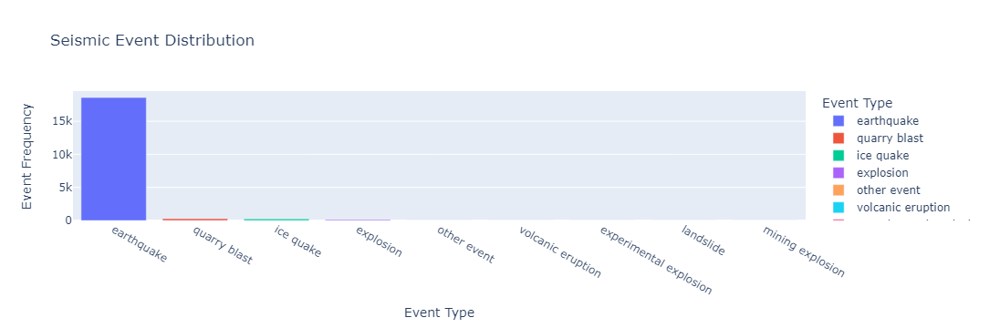

In [4]:
# Get the value counts for the 'type' column
type_counts = df['type'].value_counts().reset_index()
type_counts.columns = ['type', 'count']

# Plotting the bar chart using Plotly Express
fig = px.bar(type_counts, x='type', y='count', title='Seismic Event Distribution',
             labels={'type': 'Event Type', 'count': 'Event Frequency'},
            color ='type')

# Show the plot
fig.show()

**As shown in the chart above, earthquake events occurred 18,581 times, representing the majority of recorded incidents, while other types, such as volcanic eruptions, experimental explosions, landslides, and mining explosions, were relatively rare, each occurring only a handful of times.**

## 2. What magnitudes characterize the seismic events observed during the specified time period?

In [15]:
# Plotting the box plot for the 'mag' column
fig = px.box(df, y='mag', title='A Box Plot of the Magnitude Seismic Events',
             labels={'mag': 'Magnitude'})

# Adjust the height and width of the plot
fig.update_layout(
    height=600,  
    width=800 
)

# Show the plot
fig.show()


**As shown in the plot above, the seismic events exhibit a diverse range of magnitudes. The interquartile range (IQR), representing the middle 50% of the data, spans from 1.32 to 2.47 units. The median magnitude (50th percentile) is 1.80, while the 25th and 75th percentiles are 1.32 and 2.47 units, respectively. Outliers, represented as individual points beyond the whiskers in the box plot, suggest instances of more intense seismic events, with the maximum recorded magnitude reaching 7.10 units. Hence, monitoring and understanding these magnitudes are crucial for assessing seismic risks and implementing appropriate safety measures.**

## 3. What depth range characterizes the seismic events observed within the specified time frame?

In [16]:
# Plotting the histogram for the depth column
fig = px.histogram(df, x='depth', title='Distribution of Seismic Event Depths',
                   labels={'depth': 'Depth'},
                   color ='type',
                   # Adjust opacity for better visibility
                   opacity=0.7,  )    
                   #color_discrete_sequence=['blue'])
    # Adjust the height and width of the plot
fig.update_layout(
    xaxis_title='Depth',  
    yaxis_title='Frequency',
    height=600, 
    width=800    
)

# Show the plot
fig.show()


**The plot above reveals the existence of negative depths, with the majority of the seismic event having depths within the range of 5 to 15 units.**

**Notable, only explosions and quarry blast events had negative depths, indicating that the event occured upward from sea level**

**More so, all other siesmic events asides earthquakes had depths lower than 6 units.**

## 4. Which seismic detection and location method prevailed during the specified period?

In [17]:
# Plotting the pie chart for the 'status' column
fig = px.pie(df, names='status', title='Distribution of Earthquake Status',
             labels={'status': 'Status'}, color_discrete_sequence=px.colors.sequential.RdBu)

# Show the plot
fig.show()

**About 87% of the seismic events were manually inspected and validated.**

### 5. Which geographical area is associated with the most seismic activity during the study timeframe?

We will visually explore the geographical areas with the highest records of seismic events during the specified timeframe.

To achieve this, we will perform a data splitting operation on the 'state_country' column, aiming to extract the country names associated with the geographical locations of seismic events.

In [18]:
# spliting the values in the state_country column
df['country'] = df['state_country'].apply(lambda x: x.split(',')[-1].strip() if ',' in x else x.strip())

In [19]:
df.head()

,time.1,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource,state_country,country
time,,,,,,,,,,,,,,,,,,,,,
2023-11-15 09:05:07.304000+00:00,2023-11-15 09:05:07.304000+00:00,61.580800,-149.847000,32.800000,1.70,ml,0,0.0,0.0,0.22,...,earthquake,0.00,0.20,0.00,0,automatic,ak,ak,"Beavertail Drive, Matanuska-Susitna, Alaska, U...",United States
2023-11-15 08:53:06.688000+00:00,2023-11-15 08:53:06.688000+00:00,61.079400,-147.883000,14.800000,1.00,ml,0,0.0,0.0,0.80,...,earthquake,0.00,0.30,0.00,0,automatic,ak,ak,"Chugach, Alaska, United States",United States
2023-11-15 08:41:52.480000+00:00,2023-11-15 08:41:52.480000+00:00,19.380667,-155.285339,0.320000,1.73,md,15,153.0,0.0,0.20,...,earthquake,0.33,0.38,0.59,15,automatic,hv,hv,"Volcano, Volcano CDP, Hawaiʻi County, Hawaii, ...",United States
2023-11-15 07:44:53.035000+00:00,2023-11-15 07:44:53.035000+00:00,61.638200,-149.782800,32.900000,1.90,ml,0,0.0,0.0,0.31,...,earthquake,0.00,0.20,0.00,0,automatic,ak,ak,"Houston, Matanuska-Susitna, Alaska, 99694, Uni...",United States
2023-11-15 07:19:44.540000+00:00,2023-11-15 07:19:44.540000+00:00,18.972166,-155.451660,34.759998,1.87,md,37,236.0,0.0,0.12,...,earthquake,0.71,0.89,0.88,5,automatic,hv,hv,United States,United States


Good!!!

Now, we will plot the data on a map

In [20]:
import plotly.express as px

fig = px.scatter_geo(
    scope="world",
    data_frame=df,
    lon=df.longitude,
    lat=df.latitude,
    hover_data=df,
    color=df.country,
    basemap_visible=True,
    color_discrete_sequence=px.colors.qualitative.Set1  # Use a qualitative color scale
)

fig.update_geos(
    resolution=50,
    lonaxis={"range": [-180, 180]},
    lataxis={"range": [67, -4]}
)

fig.update_layout(
    height=800,
    legend=dict(
        orientation="h",
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1
    )
)

fig.show()


**The plot reveals that the United States has the highest number of seismic events, with Indonesia and Canada following closely. Interestingly, the map illustrates limited seismic activity in Africa and Australia, while North America experiences the most occurrences.**